In [1]:
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
plt.style.use('fivethirtyeight')
pd.set_option('display.max_columns', None)
plt.rcParams['figure.figsize'] = [6, 4]
import ast
import seaborn as sns
import nltk
import re
from nltk.tokenize import word_tokenize
import contractions
nltk.download('stopwords')
stop_words = set(nltk.corpus.stopwords.words('english'))
import spacy
nlp = spacy.load('en_core_web_sm')
import string
punctuation_string = string.punctuation
punctuation_string += '’'
punctuation = str.maketrans('', '', punctuation_string)
import wordcloud
from wordcloud import WordCloud, STOPWORDS
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import TruncatedSVD

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/shaheedismail/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [2]:
transcripts = pd.read_csv('./data/transcripts.csv')
ted_main = pd.read_csv('./data/ted_main.csv')

In [3]:
ratings_all = list(ted_main['ratings'].apply(eval).values)
names_set = set()


for i, rating_list in enumerate(ratings_all):
    for j, dict_num in enumerate(rating_list):
        names_set.add(dict_num['name'])
        
dict_ratings = {key: 0 for key in names_set}


for i, rating_list in enumerate(ratings_all):
    for j, dict_num in enumerate(rating_list):
        for name in names_set:
            if dict_num['name'] == name:
                dict_ratings[name] = dict_num['count']
                
def shape_dict(list_of_rating, names_in_set, rating_dict):
    for j, dict_num in enumerate(list_of_rating):
        for name in names_in_set:
            if dict_num['name'] == name:
                rating_dict[name] = dict_num['count']
    return rating_dict

print(names_set)

def extract_name_count(row):
    name_count = {}
    for item in row:
        name_count[item['name']] = item['count']
    return name_count

{'Funny', 'Persuasive', 'Jaw-dropping', 'Obnoxious', 'Confusing', 'Courageous', 'Fascinating', 'Longwinded', 'Informative', 'Ingenious', 'OK', 'Unconvincing', 'Inspiring', 'Beautiful'}


In [4]:
values = ted_main['tags'].apply(eval).values
word_set = set()
word_list = list()

for i in values:
    for j in i:
        word_set.add(j)
        word_list.append(j)
        
word_dict = {key: 0 for key in word_set}

for i in word_dict.keys():
    count = 0
    for j in word_list:
        if i == j:
            count +=1 
        word_dict[i] = count
        
sorted_word_counts = sorted(word_dict.items(), key=lambda x: x[1], reverse=True)
for word, count in sorted_word_counts[:20]:  
    print(f'{word}: {count}')

technology: 727
science: 567
global issues: 501
culture: 486
TEDx: 450
design: 418
business: 348
entertainment: 299
health: 236
innovation: 229
society: 224
art: 221
social change: 218
future: 195
communication: 191
biology: 189
creativity: 189
humanity: 182
collaboration: 174
environment: 165


In [5]:
df = (ted_main
 #.head(20)
 .assign(film_date = lambda df_: 
         pd.to_datetime(df_.film_date, unit='s').dt.date)
 .assign(published_date = lambda df_: 
         pd.to_datetime(df_.published_date, unit='s').dt.date)
 .assign(published_date = lambda df_: 
              pd.to_datetime(df_['published_date']))
 .assign(ratings_unpacked = lambda df_: df_.ratings.apply(eval))
 .assign(name_count = lambda df_: df_.ratings_unpacked.apply(extract_name_count))
 
 .pipe(lambda df_: pd.concat([df_.drop(['ratings_unpacked', 'name_count', 'ratings'], axis=1)
                                , df_['name_count'].apply(pd.Series)], axis=1))
 .rename(columns={'Courageous': 'rating_courageous', 'Obnoxious': 'rating_obnoxious', 'Funny': 'rating_funny',
                  'Beautiful': 'rating_beautiful', 'Ingenious': 'rating_ingenious', 'Fascinating': 'rating_fascinating',
                  'Longwinded': 'rating_longwinded', 'OK': 'rating_ok', 'Inspiring': 'rating_inspiring',
                  'Informative': 'rating_informative', 'Jaw-dropping': 'rating_jawdropping', 'Persuasive': 'rating_persuasive',
                  'Unconvincing': 'rating_unconvincing', 'Confusing': 'rating_confusing'})
 
 .assign(tag_technology = lambda df_: df_.tags.str.contains('technology').astype(int))
 .assign(tag_science = lambda df_: df_.tags.str.contains('science').astype(int))
 .assign(tag_global_issues = lambda df_: df_.tags.str.contains('global issues').astype(int))
 .assign(tag_culture = lambda df_: df_.tags.str.contains('culture').astype(int))
 .assign(tag_tedx = lambda df_: df_.tags.str.contains('TEDx').astype(int))
 .assign(tag_design = lambda df_: df_.tags.str.contains('design').astype(int))
 .assign(tag_business = lambda df_: df_.tags.str.contains('business').astype(int))
 .assign(tag_entertainment = lambda df_: df_.tags.str.contains('entertainment').astype(int))
 .assign(tag_health = lambda df_: df_.tags.str.contains('health').astype(int))
 .assign(tag_innovation = lambda df_: df_.tags.str.contains('innovation').astype(int))
 .assign(tag_society = lambda df_: df_.tags.str.contains('society').astype(int))
 .assign(tag_future = lambda df_: df_.tags.str.contains('future').astype(int))
 .assign(tag_communication = lambda df_: df_.tags.str.contains('communication').astype(int))
 .assign(tag_biology = lambda df_: df_.tags.str.contains('biology').astype(int))
 .assign(tag_creativity = lambda df_: df_.tags.str.contains('creativity').astype(int))
 .assign(tag_humanity = lambda df_: df_.tags.str.contains('humanity').astype(int))
 .assign(tag_collaboration = lambda df_: df_.tags.str.contains('collaboration').astype(int))
 .assign(tag_environment = lambda df_: df_.tags.str.contains('environment').astype(int))
)

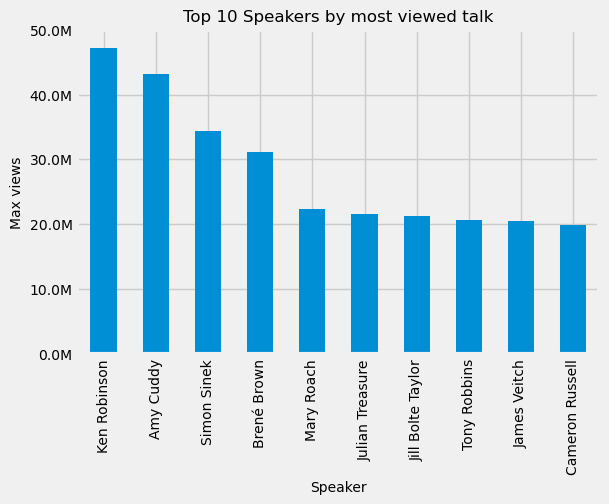

In [6]:
ax = (df.groupby('main_speaker')['views'].agg(['sum', 'count', 'mean', 'max'])
 .sort_values(by= 'max', ascending=False).head(10))[['max']].plot(kind='bar', legend = None)

y_ticks = ax.get_yticks()/1000000
ax.set_yticks(ax.get_yticks())
ax.set_yticklabels(['{:,.1f}M'.format(y) for y in y_ticks], fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=10)
plt.title('Top 10 Speakers by most viewed talk', fontsize = 12)
plt.ylabel('Max views', fontsize = 10)
plt.xlabel('Speaker', fontsize=10)
plt.show();

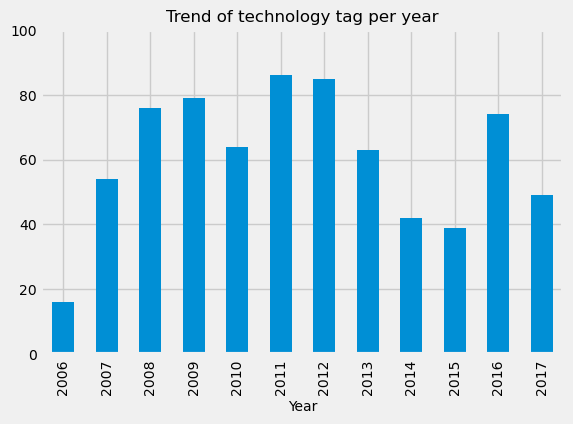

In [7]:
ax = (df.groupby(df.published_date.dt.year)['tag_technology'].sum().plot(kind='bar'))

y_ticks = ax.get_yticks()
ax.set_yticks(ax.get_yticks())
ax.set_yticklabels(['{:,.0f}'.format(y) for y in y_ticks], fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=10)
plt.title('Trend of technology tag per year', fontsize = 12)
#plt.ylabel('Max views', fontsize = 10)
plt.xlabel('Year', fontsize=10)
plt.show();

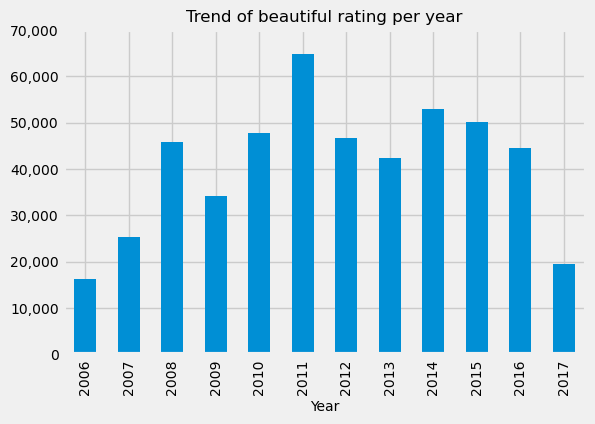

In [8]:
ax = (df.groupby(df.published_date.dt.year)['rating_beautiful'].sum().plot(kind='bar'))

y_ticks = ax.get_yticks()
ax.set_yticks(ax.get_yticks())
ax.set_yticklabels(['{:,.0f}'.format(y) for y in y_ticks], fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=10)
plt.title('Trend of beautiful rating per year', fontsize = 12)
#plt.ylabel('Max views', fontsize = 10)
plt.xlabel('Year', fontsize=10)
plt.show();

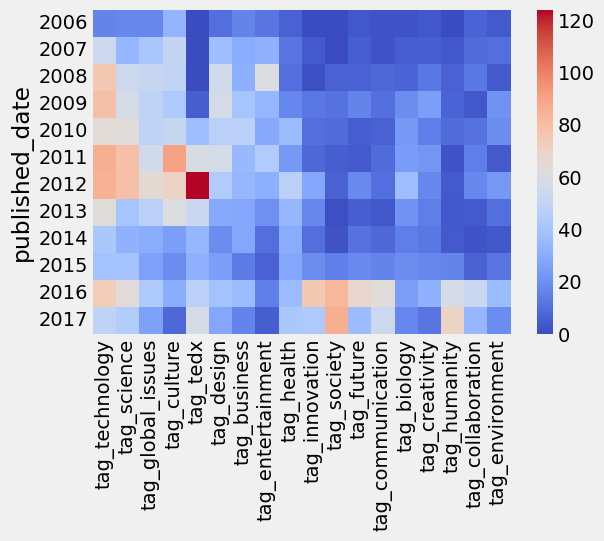

In [9]:
tags = df.groupby(df.published_date.dt.year)[['tag_technology', 'tag_science',
       'tag_global_issues', 'tag_culture', 'tag_tedx', 'tag_design',
       'tag_business', 'tag_entertainment', 'tag_health', 'tag_innovation',
       'tag_society', 'tag_future', 'tag_communication', 'tag_biology',
       'tag_creativity', 'tag_humanity', 'tag_collaboration',
       'tag_environment']].sum()

sns.heatmap(tags, cmap='coolwarm');

<Axes: >

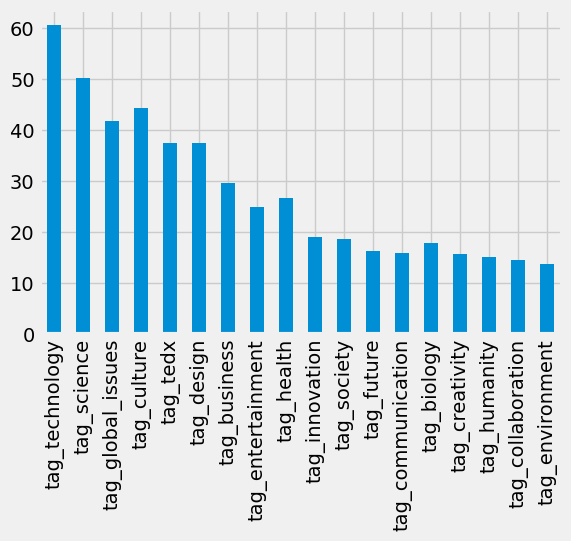

In [10]:
tags.mean().plot(kind='bar')

In [11]:
transcripts = (transcripts
 .assign(processed_text=lambda df_: df_.transcript
         .astype(str)
         .str.lower()
         .apply(word_tokenize)
         .apply(lambda tokens: ' '.join([w for w in tokens if not w in stop_words]))
         .apply(lambda x: contractions.fix(x))
         .apply(lambda x: re.sub('[0-9]+','', x)) #remove numbers
         .apply(lambda x: re.sub('@ [A-z]+','',x)) #remove twitter handles
         .apply(lambda x: x.translate(punctuation))
         .apply(lambda x: re.sub(r'((http|ftp|https)://)?([\w.-]*)\.([\w]*)+',' ', x)) #remove URLs
         .apply(lambda x: re.sub(r'(http|ftp|https)://t\.co/[a-zA-Z0-9\-\.]{10}', ' ', x)) #remove t.co URLs
         .apply(lambda x: re.compile(pattern = "[" 
                                                u"\U0001F600-\U0001F64F"
                                                u"\U0001F300-\U0001F5FF"
                                                u"\U0001F680-\U0001F6FF"
                                                u"\U0001F1E0-\U0001F1FF"
                                                "]+", flags = re.UNICODE)
                                                .sub(r'', x))
         .apply(lambda x: re.sub(u"\uf8ff", '', x))
         .apply(lambda x: ' '.join(x.split()))
         .apply(lambda x: ' '.join([token.lemma_ for token in nlp(x)]))
         .apply(lambda x: re.sub('\s\S(?!\S)|(?<!\S)\S\s', '', x))
         .apply(lambda x: re.sub(r'\b\w{16,}\b', '', x))
        ))

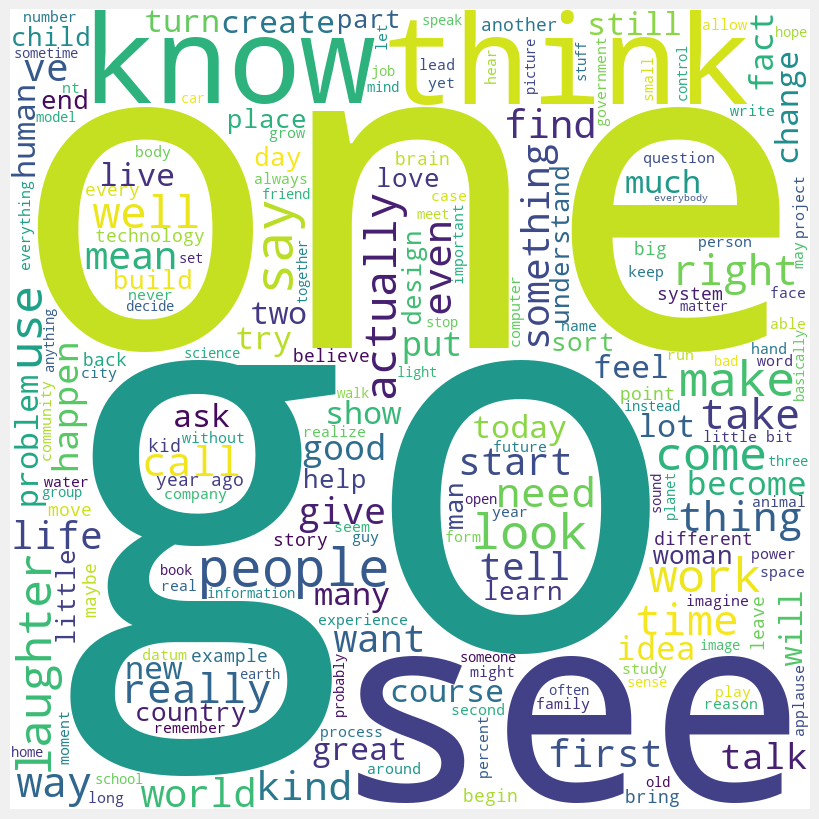

In [12]:
words =''
for val in transcripts.processed_text:
    val = str(val)
    tokens = val.split()

    words += " ".join(tokens) + " "

wordcloud = WordCloud(width=800, height=800, background_color='white'
                      , min_font_size=10).generate(words)

plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)
plt.show()

In [13]:
df =df.merge(transcripts, on='url')

In [14]:
df.sample()

,comments,description,duration,event,film_date,languages,main_speaker,name,num_speaker,published_date,related_talks,speaker_occupation,tags,title,url,views,rating_funny,rating_beautiful,rating_ingenious,rating_courageous,rating_longwinded,rating_confusing,rating_informative,rating_fascinating,rating_unconvincing,rating_persuasive,rating_jawdropping,rating_ok,rating_obnoxious,rating_inspiring,tag_technology,tag_science,tag_global_issues,tag_culture,tag_tedx,tag_design,tag_business,tag_entertainment,tag_health,tag_innovation,tag_society,tag_future,tag_communication,tag_biology,tag_creativity,tag_humanity,tag_collaboration,tag_environment,transcript,processed_text
1090,181,Has our technology -- our cell phones and iPod...,456,INK Conference,2011-12-09,35,Shilo Shiv Suleman,Shilo Shiv Suleman: Using tech to enable dreaming,1,2012-02-22,"[{'id': 1134, 'hero': 'https://pe.tedcdn.com/i...",Artist,"['art', 'creativity']",Using tech to enable dreaming,https://www.ted.com/talks/shilo_shiv_suleman_u...,576918,15,282,122,32,33,32,36,158,85,29,34,110,32,212,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,My story begins right here actually in Rajasth...,story begin right actually rajasthan two year ...


In [15]:


data = df.processed_text.tolist()


tfidf_vectorizer = TfidfVectorizer(stop_words='english', ngram_range=(0,1))
tfidf_matrix = tfidf_vectorizer.fit_transform(data)


kmeans = KMeans(n_clusters=10, random_state=42, n_init=10)
kmeans.fit(tfidf_matrix)

cluster_labels = kmeans.labels_

df = df.assign(cluster = cluster_labels)



In [16]:
# Print top terms per cluster
order_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]
terms = tfidf_vectorizer.get_feature_names_out()
clusters =[]

for i in range(10):
    terms_in = []
    for ind in order_centroids[i, :20]:
        terms_in.append(terms[ind])
        
    clusters.append(terms_in)

In [17]:
cluster_makeup = pd.DataFrame(clusters).reset_index().rename(columns = {'index':'cluster'})

In [18]:
df = df.merge(cluster_makeup, on='cluster').rename(columns = 
                                             {0:'word1',
                                              1:'word2',2:'word3',
                                              3:'word4',4:'word5',5:'word6',6:'word7',7:'word8'
                                              ,8:'word9',9:'word10',10:'word11',11:'word12',12:'word13',
                                              13:'word14',14:'word15',15:'word16',16:'word17',17:'word18',
                                              18:'word19',19:'word20'})

In [19]:
cluster_makeup

,cluster,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0,water,ocean,fish,sea,forest,coral,earth,ice,like,planet,year,animal,know,climate,look,time,ve,mar,shark,make
1,1,woman,girl,man,say,people,know,like,think,child,make,boy,mother,tell,want,world,year,laughter,school,work,time
2,2,brain,cell,patient,cancer,disease,drug,like,neuron,people,actually,think,look,make,thing,know,body,doctor,health,use,say
3,3,people,country,world,year,think,city,percent,make,like,thing,need,say,africa,government,energy,economy,problem,ve,dollar,company
4,4,robot,like,robotic,use,leg,machine,laughter,look,human,make,thing,really,animal,actually,want,think,design,build,rezero,work
5,5,music,applause,sound,play,like,guitar,hear,musician,laughter,orchestra,musical,violin,make,thank,song,instrument,start,piece,noise,really
6,6,dna,plant,animal,like,gene,cell,bacteria,specie,genome,think,make,look,thing,human,year,really,virus,know,bee,ve
7,7,people,like,make,think,say,know,use,time,year,thing,want,laughter,world,work,look,way,come,ve,actually,city
8,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid
9,9,universe,star,galaxy,planet,telescope,particle,earth,light,space,sun,hole,like,theory,look,black,solar,year,energy,billion,thing


In [20]:
df.columns

Index(['comments', 'description', 'duration', 'event', 'film_date',
       'languages', 'main_speaker', 'name', 'num_speaker', 'published_date',
       'related_talks', 'speaker_occupation', 'tags', 'title', 'url', 'views',
       'rating_funny', 'rating_beautiful', 'rating_ingenious',
       'rating_courageous', 'rating_longwinded', 'rating_confusing',
       'rating_informative', 'rating_fascinating', 'rating_unconvincing',
       'rating_persuasive', 'rating_jawdropping', 'rating_ok',
       'rating_obnoxious', 'rating_inspiring', 'tag_technology', 'tag_science',
       'tag_global_issues', 'tag_culture', 'tag_tedx', 'tag_design',
       'tag_business', 'tag_entertainment', 'tag_health', 'tag_innovation',
       'tag_society', 'tag_future', 'tag_communication', 'tag_biology',
       'tag_creativity', 'tag_humanity', 'tag_collaboration',
       'tag_environment', 'transcript', 'processed_text', 'cluster', 'word1',
       'word2', 'word3', 'word4', 'word5', 'word6', 'word7', 'word8', 

In [21]:
df.groupby('cluster')['cluster'].count()

cluster
0    140
1    132
2    189
3    264
4     30
5     62
6    147
7    848
8    604
9     51
Name: cluster, dtype: int64

In [22]:
sid_obj = SentimentIntensityAnalyzer()
df = (df
 .assign(vd_sentiment_score = lambda df_ : df_.processed_text.apply(lambda x: sid_obj.polarity_scores(str(x))['compound']))
 .assign(vd_sentiment_cat = lambda df_: np.select([(df_.vd_sentiment_score.between(-0.05, 0.05)),
                                                (df_.vd_sentiment_score>0),
                                                (df_.vd_sentiment_score<0)],
                                                 ['neut', 'pos', 'neg']))
 .astype({'vd_sentiment_cat': 'category'}))

In [23]:
df[df['vd_sentiment_cat']=='neg']

,comments,description,duration,event,film_date,languages,main_speaker,name,num_speaker,published_date,related_talks,speaker_occupation,tags,title,url,views,rating_funny,rating_beautiful,rating_ingenious,rating_courageous,rating_longwinded,rating_confusing,rating_informative,rating_fascinating,rating_unconvincing,rating_persuasive,rating_jawdropping,rating_ok,rating_obnoxious,rating_inspiring,tag_technology,tag_science,tag_global_issues,tag_culture,tag_tedx,tag_design,tag_business,tag_entertainment,tag_health,tag_innovation,tag_society,tag_future,tag_communication,tag_biology,tag_creativity,tag_humanity,tag_collaboration,tag_environment,transcript,processed_text,cluster,word1,word2,word3,word4,word5,word6,word7,word8,word9,word10,word11,word12,word13,word14,word15,word16,word17,word18,word19,word20,vd_sentiment_score,vd_sentiment_cat
21,52,Musician and activist Peter Gabriel shares his...,848,TED2006,2006-02-23,24,Peter Gabriel,Peter Gabriel: Fight injustice with raw video,1,2006-12-06,"[{'id': 75, 'hero': 'https://pe.tedcdn.com/ima...","Musician, activist","['TED Brain Trust', 'activism', 'art', 'collab...",Fight injustice with raw video,https://www.ted.com/talks/peter_gabriel_fights...,904215,5,23,36,180,25,8,145,27,14,92,33,36,3,222,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,"I love trees, and I'm very lucky, because we l...",love tree lucky live near wonderful arboretum ...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,-0.9455,neg
33,40,Nora York gives a stunning performance of her ...,276,TEDSalon 2006,2006-12-14,28,Nora York,"Nora York: Singing ""What I Want""",1,2007-04-05,"[{'id': 158, 'hero': 'https://pe.tedcdn.com/im...","Singer, performance artist","['entertainment', 'live music', 'music', 'perf...","Singing ""What I Want""",https://www.ted.com/talks/nora_york_sings_what...,395769,11,123,17,22,3,7,2,38,20,5,22,31,13,71,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,I'd like to begin this song I wrote about ceas...,would like begin song write ceaseless yearn ne...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,-0.9154,neg
59,262,Surgeon and author Sherwin Nuland discusses th...,1338,TED2003,2001-02-02,26,Sherwin Nuland,Sherwin Nuland: How electroshock therapy chang...,1,2007-10-30,"[{'id': 441, 'hero': 'https://pe.tedcdn.com/im...",Doctor,"['brain', 'depression', 'health care', 'illnes...",How electroshock therapy changed me,https://www.ted.com/talks/sherwin_nuland_on_el...,1522858,95,308,37,1417,54,16,453,466,39,128,121,44,28,1286,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,I'd like to do pretty much what I did the firs...,would like pretty much first time choose light...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,-0.9726,neg
104,383,Philip Zimbardo knows how easy it is for nice ...,1396,TED2008,2008-02-02,33,Philip Zimbardo,Philip Zimbardo: The psychology of evil,1,2008-09-23,"[{'id': 163, 'hero': 'https://pe.tedcdn.com/im...",Psychologist,"['children', 'crime', 'culture', 'education', ...",The psychology of evil,https://www.ted.com/talks/philip_zimbardo_on_t...,5842377,50,136,217,738,85,52,1288,1296,51,904,785,128,52,1599,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"Philosophers, dramatists, theologians have gra...",philosopher dramatist theologian grapple quest...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,-0.9995,neg
145,280,Behavioral economist Dan Ariely studies the bu...,983,TED2009,2009-02-07,36,Dan Ariely,Dan Ariely: Our buggy moral code,1,2009-03-17,"[{'id': 420, 'hero': 'https://pe.tedcdn.com/im...",Behavioral economist,"['brain', 'culture', 'economics', 'evil', 'mot...",Our buggy moral code,https://www.ted.com/talks/dan_ariely_on_our_bu...,2725557,307,113,644,253,27,15,1502,1722,27,1101,235,90,11,796,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,I want to talk to you today a little bit ab

In [24]:
df.reset_index().to_csv('tableau.csv')

In [25]:
df.corr(numeric_only=True)['views'].sort_values()

tag_global_issues     -0.089179
tag_design            -0.074863
tag_technology        -0.070912
tag_environment       -0.062976
tag_future            -0.048334
tag_collaboration     -0.042842
tag_innovation        -0.041407
tag_biology           -0.034159
tag_society           -0.026300
num_speaker           -0.025561
tag_science           -0.023979
tag_humanity          -0.018558
tag_tedx              -0.012186
tag_health            -0.002303
tag_communication      0.007708
tag_creativity         0.032094
tag_entertainment      0.036747
vd_sentiment_score     0.039147
tag_business           0.062003
duration               0.064887
tag_culture            0.108581
cluster                0.124904
rating_obnoxious       0.257941
rating_unconvincing    0.277368
languages              0.396389
rating_confusing       0.409257
rating_jawdropping     0.439972
rating_longwinded      0.453469
comments               0.530383
rating_beautiful       0.556889
rating_courageous      0.559158
rating_f

In [26]:
vectorizer = CountVectorizer()
dtm = vectorizer.fit_transform(transcripts.processed_text)
feature_names = vectorizer.get_feature_names_out()



dtm_df = pd.DataFrame(dtm.toarray(), columns=feature_names)

dtm_df.head()



,aa,aaa,aaaa,aaaaa,aaaaaaaah,aaaaaaaargh,aaaaaaah,aaaaaah,aaaaaahrp,aaaaaasking,aaaab,aaaah,aaaahhh,aaah,aag,aah,aahsw,aak,aakash,aaleh,aalto,aand,aare,aargh,aarhus,aaron,aaronson,aarp,aat,aatcagggaccc,aaudience,ab,aba,ababa,abacazanian,abacha,abaci,aback,abaco,abacus,abalone,abandon,abandoned,abandonedand,abandonment,abani,abarth,abashedly,abate,abatement,abattoir,abaya,abba,abbas,abbeel,abbey,abbott,abbottabad,abbreviate,abbreviation,abby,abc,abdellahy,abdelmagied,abdelrahman,abdi,abdicate,abdication,abdirizak,abdoman,abdomen,abdominal,abduct,abducted,abductee,abduction,abdul,abduljabbar,abdullah,abdullatif,abdur,abdurrahman,abe,abecedarian,abed,abegg,abell,abend,aberdeen,abernathey,abernathy,aberrance,aberrant,aberration,abet,abettance,abhor,abhorrent,abide,abidjan,abigail,abilitiesnow,abilitiesthink,ability,abilityi,abilitynow,abilityso,abiola,abissinia,abject,ablate,ablation,ablaze,ablazei,able,ablebodie,ablebodied,ableism,abnormal,abnormality,abnormally,aboard,abobiri,abode,abolish,abolition,abolitionism,abolitionist,abololo,abomb,abominable,abomination,aboody,aboriginal,aborigine,abort,aborting,abortion,abou,abound,about,aboutal,aboutalthough,aboutand,aboutanyway,aboutattend,aboutbut,aboutca,aboutcr,aboutdb,aboutfc,aboutfor,aboutgb,abouthe,abouthow,abouti,aboutif,aboutindeed,aboutjust,aboutlast,aboutlet,aboutness,aboutnow,aboutok,aboutone,aboutph,aboutrd,aboutrs,aboutsecondly,aboutso,aboutstart,abouttb,aboutthank,aboutthe,aboutthen,aboutthis,aboutwe,aboutwhat,aboutwhy,aboutyes,abovea,aboveaverage,aboveboard,aboveground,aboveknee,aboveso,abovetheelbow,abovethetitle,abovethis,abra,abracadabra,abracadabramt,abraham,abrahamic,abramovich,abramowitz,abrams,abrasion,abrasive,abreu,abric,abridge,abridged,abroad,abroadbut,abroadso,abrogate,abrupt,abruptly,abs,abscess,abscond,abseil,absence,absencemarriage,absencenl,absent,absentee,absenteeism,absentminded,absinthe,absolute,absolutely,absolutelyhg,absolutelypm,absolutelytr,absoluteness,absolutesnow,absolutionand,absolutism,absolve,absorb,absorbed,absorbedand,absorbent,absorber,absorbing,absorption,absorptionso,absorptive,absquatulate,abstain,abstainer,abstinence,abstract,abstractbut,abstraction,abstractionand,abstractioni,abstractionsnow,abstractly,abstruse,absurd,absurdism,absurdist,absurdity,absurdly,abu,abubakar,abuela,abuh,abuja,abundance,abundant,abundantly,abus,abuse,abused,abusedlp,abuseeventually,abuser,abusive,abuzaid,abuzz,abysmal,abyss,abyssbut,abzug,ac,acacia,academia,academic,academically,academicallyso,academician,academicswhat,academy,acai,acapulco,acc,accede,accelerant,accelerate,accelerated,acceleration,accelerationso,accelerative,accelerator,accelerators,accelerometer,accelerometers,accelerometerso,accelerometry,accent,accentbut,accentso,accentss,accentsso,accentuate,accenture,accept,acceptable,acceptablein,acceptablenow,acceptablethis,acceptance,acceptancea,acceptanceand,acceptancemany,accepted,acceptedi,accepti,accepting,acceptsso,acceptwhat,access,accessi,accessibility,accessible,accessiblenow,accessibleor,accessibleso,accessiblewe,accessibly,accessing,accessjust,accessnow,accessoriesso,accessorize,accessory,accesssecondly,accessso,accident,accidental,accidentally,accidentand,accidentbwm,accidentprone,accidentso,acclaim,acclimate,acclimatize,accolade,accommodate,accommodation,accomodate,accompanie,accompanied,accompaniment,accompanist,accompany,accomplice,accomplish,accomplishable,accomplishand,accomplished,accomplishedso,accomplishedthe,accomplishit,accomplishment,accomplishso,accor,accord,accordance,according,accordingly,accordinglyand,accordion,accordionfolde,accost,account,accountabilitie,accountability,accountable,accountancy,accountand,accountant,accounted,accounting,accountnow,accountsbee,accra,accredit,accreditation,accretion,accretional,accrue,accumben,accumbens,accumulate,accumulated,accumulatenow,accumulateso,accumulation,accuracy,accuracyand,accuracyso,accuracytr,accuracywhen,accurate,accurateand,accurately,accuratelyand,accuratelyso,accurateon,ac

In [27]:
# Perform SVD on the Document-Term Matrix
svd = TruncatedSVD(n_components=10)  # Specify the number of components (topics)
svd_matrix = svd.fit_transform(dtm)

# Display the SVD results
print(svd_matrix)

[[ 77.89931247  32.46428502  -9.59235515 ...  -2.64383405   6.93638341
   18.08994923]
 [ 39.27911163   8.22586331  -0.33680456 ...  -9.42621356   4.02211268
    9.17755025]
 [ 75.26947281  13.60215168 -17.60617534 ... -23.16265087  11.38567262
   21.28562262]
 ...
 [ 30.4282597  -14.35419435  -4.01801128 ...   0.3623631    1.99211085
   -4.41438373]
 [ 50.00788618   4.48919175   1.18335847 ...  -8.09419764   3.15236489
    0.65992274]
 [ 21.80481543  -8.61700589   5.46569118 ...  -1.58524171   0.86229448
   -6.19597739]]


In [28]:
# Inspect the SVD components
components = svd.components_

# Number of top terms to display per topic
top_terms = 20

# Map components to terms and display top terms per topic
for i, topic in enumerate(components):
    top_indices = topic.argsort()[-top_terms:][::-1]  # Get indices of top terms
    top_terms_topic = [feature_names[ind] for ind in top_indices]  # Map indices to terms
    print(f"Topic {i+1}: {', '.join(top_terms_topic)}")

Topic 1: go, not, be, people, one, get, like, say, think, know, would, thing, see, make, look, really, year, want, time, ve
Topic 2: say, not, laughter, know, woman, people, man, would, tell, love, want, kid, feel, talk, story, girl, school, never, child, think
Topic 3: people, world, country, year, woman, we, many, need, change, live, percent, child, city, today, government, also, even, global, life, community
Topic 4: people, be, think, thing, go, get, really, lot, ve, problem, actually, not, kind, want, money, dollar, company, something, percent, well
Topic 5: go, get, year, be, country, percent, ve, need, woman, child, come, school, water, back, kid, million, day, dollar, every, health
Topic 6: make, laughter, get, city, work, like, would, build, design, new, building, start, could, water, thing, create, kind, kid, school, energy
Topic 7: see, people, laughter, go, world, look, be, city, right, around, like, story, show, applause, image, space, country, robot, feel, galaxy
Topic 8:

In [29]:
lists=[]
names = []
for i in range(10):
    variable_name = "topic_"+str(i)
    globals()[variable_name] = [vector[i] for vector in svd_matrix]
    lists.append(globals()[variable_name])
    names.append(variable_name)
    
df_topics = pd.DataFrame(lists).transpose()
df_topics.columns = names


In [30]:
df.reset_index().merge(df_topics.reset_index(), on="index")

,index,comments,description,duration,event,film_date,languages,main_speaker,name,num_speaker,published_date,related_talks,speaker_occupation,tags,title,url,views,rating_funny,rating_beautiful,rating_ingenious,rating_courageous,rating_longwinded,rating_confusing,rating_informative,rating_fascinating,rating_unconvincing,rating_persuasive,rating_jawdropping,rating_ok,rating_obnoxious,rating_inspiring,tag_technology,tag_science,tag_global_issues,tag_culture,tag_tedx,tag_design,tag_business,tag_entertainment,tag_health,tag_innovation,tag_society,tag_future,tag_communication,tag_biology,tag_creativity,tag_humanity,tag_collaboration,tag_environment,transcript,processed_text,cluster,word1,word2,word3,word4,word5,word6,word7,word8,word9,word10,word11,word12,word13,word14,word15,word16,word17,word18,word19,word20,vd_sentiment_score,vd_sentiment_cat,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9
0,0,4553,Sir Ken Robinson makes an entertaining and pro...,1164,TED2006,2006-02-25,60,Ken Robinson,Ken Robinson: Do schools kill creativity?,1,2006-06-27,"[{'id': 865, 'hero': 'https://pe.tedcdn.com/im...",Author/educator,"['children', 'creativity', 'culture', 'dance',...",Do schools kill creativity?,https://www.ted.com/talks/ken_robinson_says_sc...,47227110,19645,4573,6073,3253,387,242,7346,10581,300,10704,4439,1174,209,24924,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,Good morning. How are you?(Laughter)It's been ...,good morning laughter great not ve blow away w...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,0.9999,pos,77.899312,32.464285,-9.592355,0.433508,-3.506831,-3.683909,6.609171,-2.643834,6.936383,18.089949
1,1,265,With the same humor and humanity he exuded in ...,977,TED2006,2006-02-25,43,Al Gore,Al Gore: Averting the climate crisis,1,2006-06-27,"[{'id': 243, 'hero': 'https://pe.tedcdn.com/im...",Climate advocate,"['alternative energy', 'cars', 'climate change...",Averting the climate crisis,https://www.ted.com/talks/al_gore_on_averting_...,3200520,544,58,56,139,113,62,443,132,258,268,116,203,131,413,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,"Thank you so much, Chris. And it's truly a gre...",thank much chris truly great honor opportunity...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,0.9997,pos,39.279112,8.225863,-0.336805,-0.973513,3.396186,8.679674,4.100556,-9.426214,4.022113,9.177550
2,2,124,New York Times columnist David Pogue takes aim...,1286,TED2006,2006-02-24,26,David Pogue,David Pogue: Simplicity sells,1,2006-06-27,"[{'id': 1725, 'hero': 'https://pe.tedcdn.com/i...",Technology columnist,"['computers', 'entertainment', 'interface desi...",Simplicity sells,https://www.ted.com/talks/david_pogue_says_sim...,1636292,964,60,183,45,78,27,395,166,104,230,54,146,142,230,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,"(Music: ""The Sound of Silence,"" Simon & Garfun...",music sound silence simon garfunkel hello voic...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,0.9998,pos,75.269473,13.602152,-17.606175,-6.427103,-2.038154,17.787648,0.942316,-23.162651,11.385673,21.285623
3,3,672,"Tony Robbins discusses the ""invisible forces"" ...",1305,TED2006,2006-02-02,36,Tony Robbins,Tony Robbins: Why we do what we do,1,2006-06-27,"[{'id': 229, 'hero': 'https://pe.tedcdn.com/im...",Life coach; expert in leadership psychology,"['business', 'culture', 'entertainment', 'goal...",Why we do what we do,https://www.ted.com/talks/tony_robbins_asks_wh...,20685401,1102,706,397,721,285,301,1038,1350,377,2423,669,441,335,5211,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,Thank you. I have to tell you I'm both challen...,thank tell challenge excited excitement get ch...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,0.9998,pos,49.481464,-4.843491,13.631423,-3.447084,-0.197749,11.805082,0.995533,-6.2903

In [31]:
df_test = pd.DataFrame(lists).transpose()
df_test.columns = names
df_test.head()

,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9
0,77.899312,32.464285,-9.592355,0.433508,-3.506831,-3.683909,6.609171,-2.643834,6.936383,18.089949
1,39.279112,8.225863,-0.336805,-0.973513,3.396186,8.679674,4.100556,-9.426214,4.022113,9.177550
2,75.269473,13.602152,-17.606175,-6.427103,-2.038154,17.787648,0.942316,-23.162651,11.385673,21.285623
3,49.481464,-4.843491,13.631423,-3.447084,-0.197749,11.805082,0.995533,-6.290341,7.733107,0.784362
4,60.616062,-6.660070,20.871546,-11.149020,15.420426,10.538081,9.086553,2.112659,6.059329,15.185787


In [33]:
#df.assign(first_terms = first_terms)

In [34]:
svd_matrix[0]

array([77.89931247, 32.46428502, -9.59235515,  0.43350804, -3.50683067,
       -3.6839092 ,  6.60917149, -2.64383405,  6.93638341, 18.08994923])

In [35]:
df

,comments,description,duration,event,film_date,languages,main_speaker,name,num_speaker,published_date,related_talks,speaker_occupation,tags,title,url,views,rating_funny,rating_beautiful,rating_ingenious,rating_courageous,rating_longwinded,rating_confusing,rating_informative,rating_fascinating,rating_unconvincing,rating_persuasive,rating_jawdropping,rating_ok,rating_obnoxious,rating_inspiring,tag_technology,tag_science,tag_global_issues,tag_culture,tag_tedx,tag_design,tag_business,tag_entertainment,tag_health,tag_innovation,tag_society,tag_future,tag_communication,tag_biology,tag_creativity,tag_humanity,tag_collaboration,tag_environment,transcript,processed_text,cluster,word1,word2,word3,word4,word5,word6,word7,word8,word9,word10,word11,word12,word13,word14,word15,word16,word17,word18,word19,word20,vd_sentiment_score,vd_sentiment_cat
0,4553,Sir Ken Robinson makes an entertaining and pro...,1164,TED2006,2006-02-25,60,Ken Robinson,Ken Robinson: Do schools kill creativity?,1,2006-06-27,"[{'id': 865, 'hero': 'https://pe.tedcdn.com/im...",Author/educator,"['children', 'creativity', 'culture', 'dance',...",Do schools kill creativity?,https://www.ted.com/talks/ken_robinson_says_sc...,47227110,19645,4573,6073,3253,387,242,7346,10581,300,10704,4439,1174,209,24924,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,Good morning. How are you?(Laughter)It's been ...,good morning laughter great not ve blow away w...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,0.9999,pos
1,265,With the same humor and humanity he exuded in ...,977,TED2006,2006-02-25,43,Al Gore,Al Gore: Averting the climate crisis,1,2006-06-27,"[{'id': 243, 'hero': 'https://pe.tedcdn.com/im...",Climate advocate,"['alternative energy', 'cars', 'climate change...",Averting the climate crisis,https://www.ted.com/talks/al_gore_on_averting_...,3200520,544,58,56,139,113,62,443,132,258,268,116,203,131,413,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,"Thank you so much, Chris. And it's truly a gre...",thank much chris truly great honor opportunity...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,0.9997,pos
2,124,New York Times columnist David Pogue takes aim...,1286,TED2006,2006-02-24,26,David Pogue,David Pogue: Simplicity sells,1,2006-06-27,"[{'id': 1725, 'hero': 'https://pe.tedcdn.com/i...",Technology columnist,"['computers', 'entertainment', 'interface desi...",Simplicity sells,https://www.ted.com/talks/david_pogue_says_sim...,1636292,964,60,183,45,78,27,395,166,104,230,54,146,142,230,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,"(Music: ""The Sound of Silence,"" Simon & Garfun...",music sound silence simon garfunkel hello voic...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,0.9998,pos
3,672,"Tony Robbins discusses the ""invisible forces"" ...",1305,TED2006,2006-02-02,36,Tony Robbins,Tony Robbins: Why we do what we do,1,2006-06-27,"[{'id': 229, 'hero': 'https://pe.tedcdn.com/im...",Life coach; expert in leadership psychology,"['business', 'culture', 'entertainment', 'goal...",Why we do what we do,https://www.ted.com/talks/tony_robbins_asks_wh...,20685401,1102,706,397,721,285,301,1038,1350,377,2423,669,441,335,5211,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,Thank you. I have to tell you I'm both challen...,thank tell challenge excited excitement get ch...,8,say,people,like,know,think,thing,laughter,make,really,want,time,ve,look,work,come,way,actually,kind,year,kid,0.9998,pos
4,919,When two young Mormon missionaries knock on Ju...,992,TED2006,2006-02-24,31,Julia Sweeney,Julia Sweeney: Letting go of God,1,2006-07-10,"[{'id': 22, 'hero': 'https://pe.tedcdn.com/ima...","Actor, comedian, playwright","['Christianity', 'God', 'atheism', 'comedy', '...",Letting go of God,https://www.ted.com/talks/julia_sweeney_on_let...,3769987,2484,277,320,477,193,72,226,316,225,311,61,308,290,438,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"On September 10, t